### Enhancing a low light light video Given by user by using exposure fusion framework

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt 

# Load a low-light video (replace 'low_light_video.mp4' with your video path)
video_path = "C:\\Users\\heman\\img_processing_python\\programs\\videos\\test_obj.mp4"
cap = cv2.VideoCapture(video_path)

# Get original video properties
fps_original = int(cap.get(cv2.CAP_PROP_FPS))
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Specify the desired frame rate
fps_desired = 500  # Adjust this to your desired frame rate

# Create VideoWriter object to save the enhanced video with increased frame rate
output_path = "C:\\Users\\heman\\img_processing_python\\programs\\videos\\enhanced_video_high_fps.avi"
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter(output_path, fourcc, fps_desired, (width, height))

# Dynamic Histogram Equalization
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))

while True:
    ret, frame = cap.read()
    if not ret:
        break

    # Convert frame to RGB
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

    # Apply dynamic histogram equalization
    enhanced_frame = np.zeros_like(frame_rgb)
    for channel in range(3):
        enhanced_frame[:, :, channel] = clahe.apply(frame_rgb[:, :, channel])

    # Simulate multiple exposure levels by adjusting intensity
    exposure_levels = [0.8, 1.0, 1.2]
    exposure_frames = [frame_rgb * exposure for exposure in exposure_levels]

    # Exposure Fusion Framework
    fusion_weights = [1, 1, 1]
    result_frame = np.zeros_like(frame_rgb, dtype=np.float32)
    for i in range(len(exposure_frames)):
        result_frame += fusion_weights[i] * exposure_frames[i].astype(np.float32)

    result_frame = np.clip(result_frame, 0, 255).astype(np.uint8)

    # Concatenate original and enhanced frames horizontally
    combined_frame = np.hstack((frame, cv2.cvtColor(result_frame, cv2.COLOR_RGB2BGR)))

    # Write the enhanced frame to the output video multiple times to increase frame rate
    for _ in range(int(fps_desired / fps_original)):
        out.write(cv2.cvtColor(result_frame, cv2.COLOR_RGB2BGR))

    # Display the combined frame
    cv2.imshow('Original vs Enhanced', combined_frame)

    # Plot histograms of original and enhanced frames
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.title('Histogram of Original Frame')
    plt.xlabel('Pixel Intensity')
    plt.ylabel('Frequency')
    plt.hist(frame_rgb.flatten(), bins=256, range=[0, 256], color='blue', alpha=0.7)

    plt.subplot(1, 2, 2)
    plt.title('Histogram of Enhanced Frame')
    plt.xlabel('Pixel Intensity')
    plt.ylabel('Frequency')
    plt.hist(result_frame.flatten(), bins=256, range=[0, 256], color='red', alpha=0.7)

    plt.show()

    if cv2.waitKey(1) & 0xFF == 27:  # Press 'Esc' to exit
        break

    # Add a short delay to allow the OpenCV window to update
    cv2.waitKey(10)

# Release video capture and writer objects
cap.release()
out.release()
cv2.destroyAllWindows()


### Enhancing the low lightvideo capturing through webcam by using exposure fusion framework

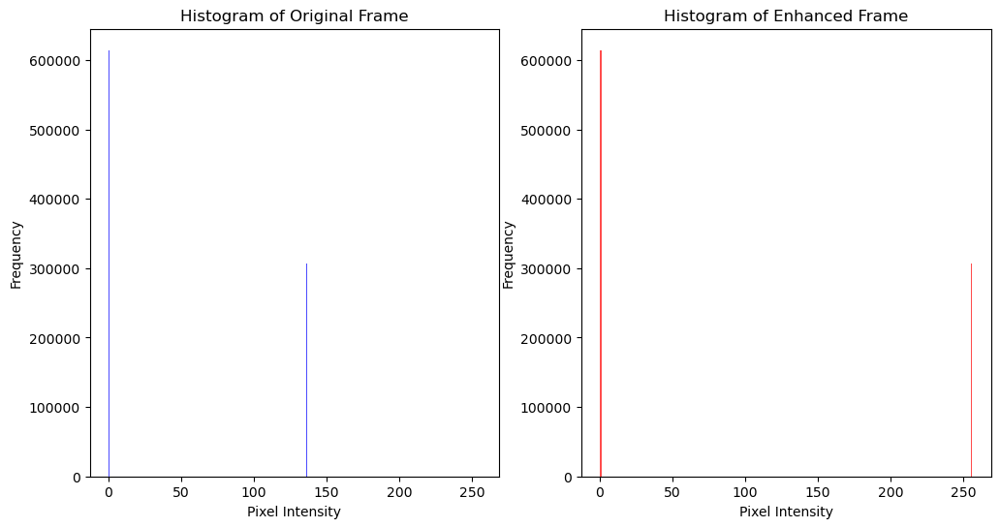

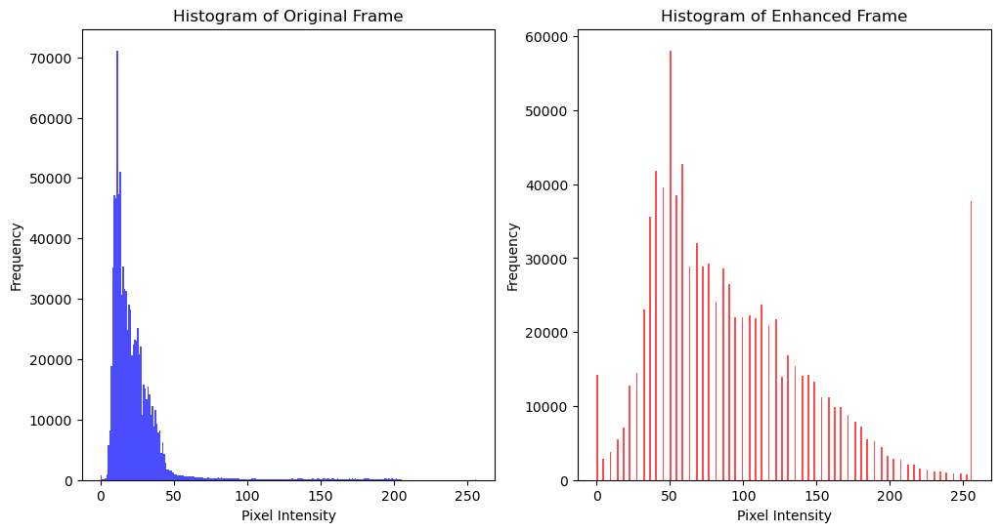

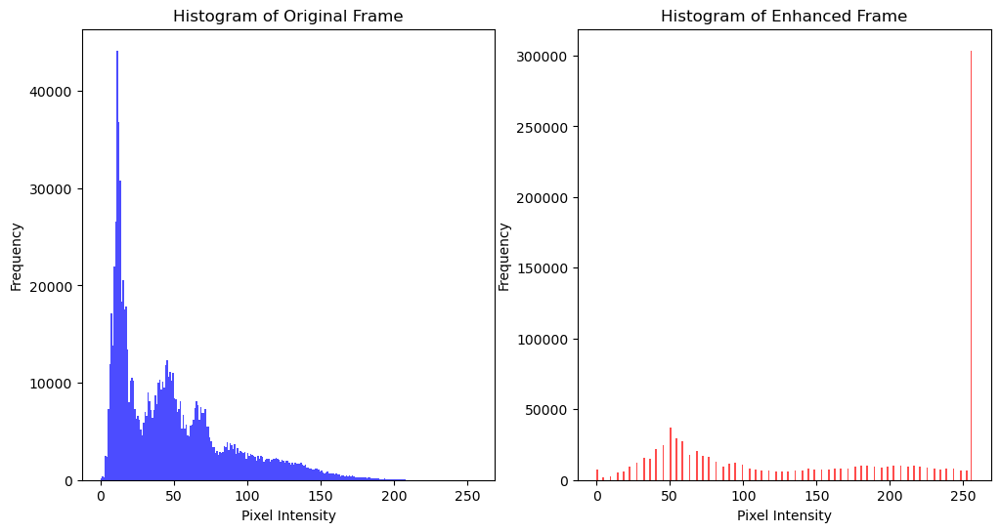

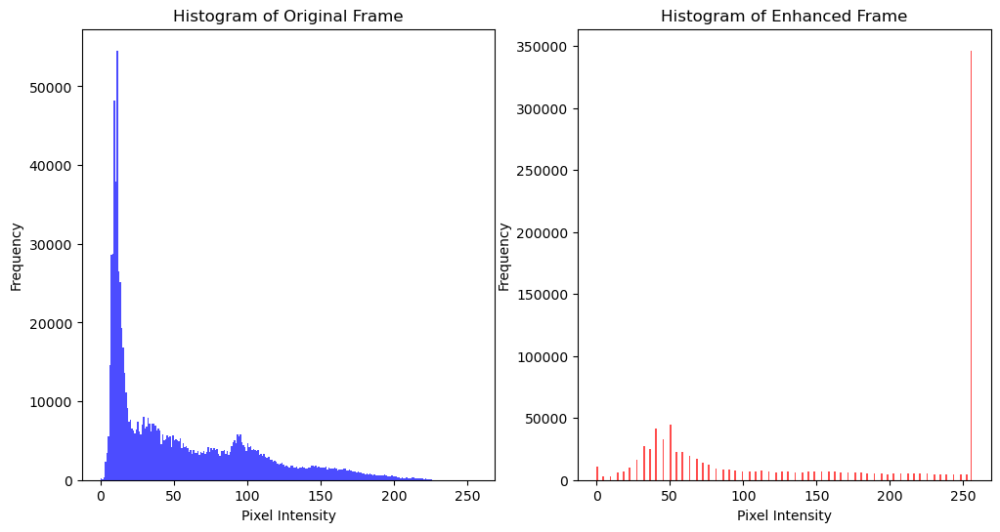

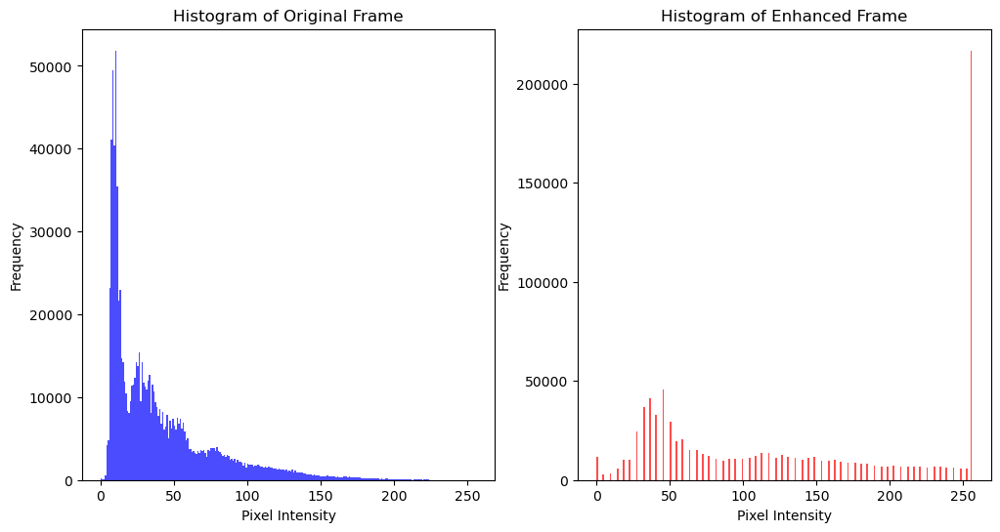

...

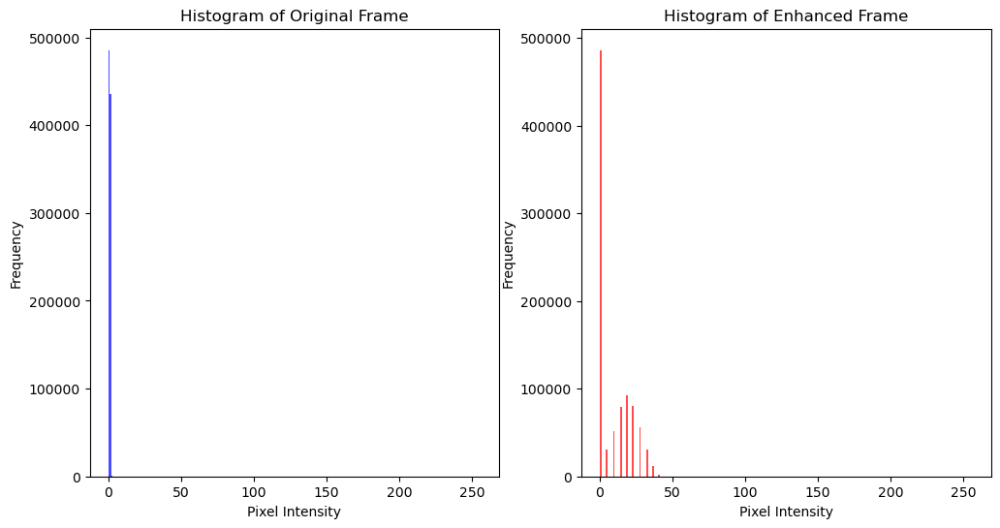

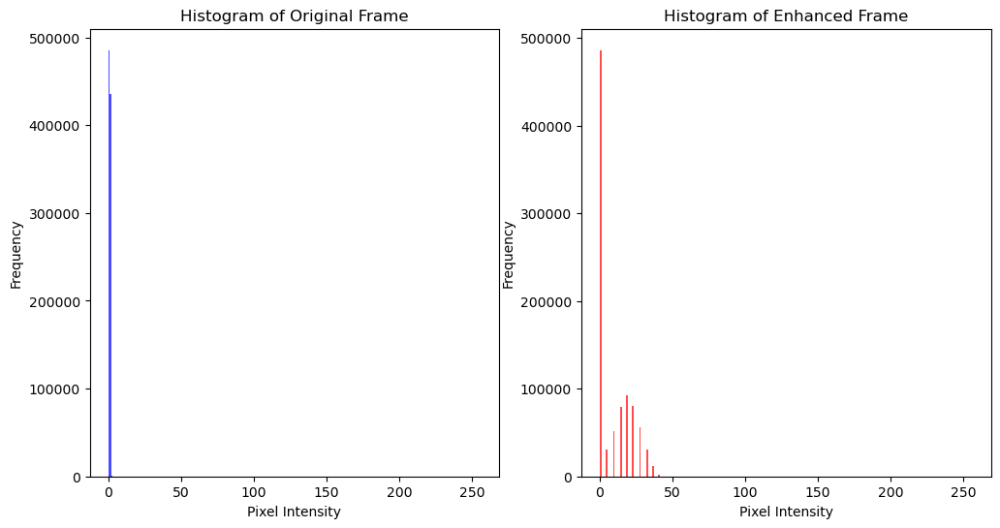

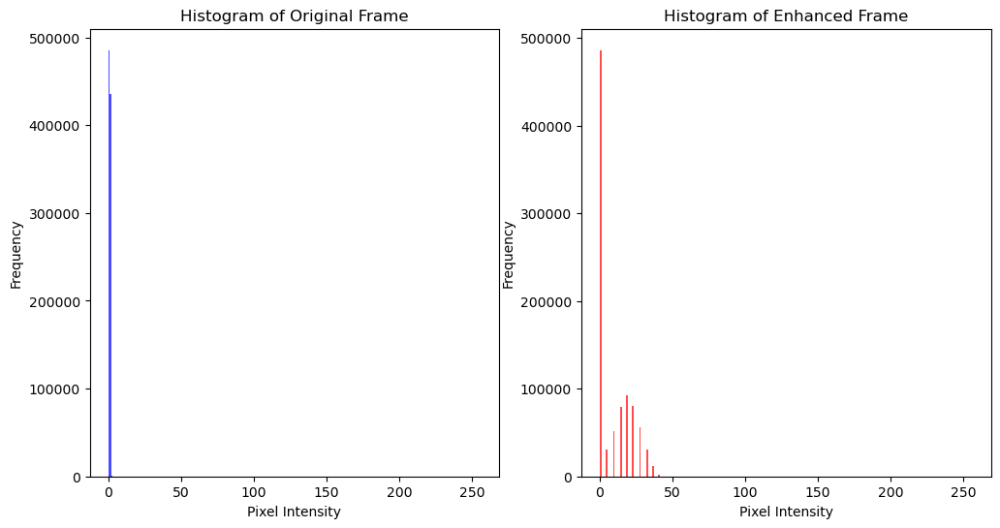

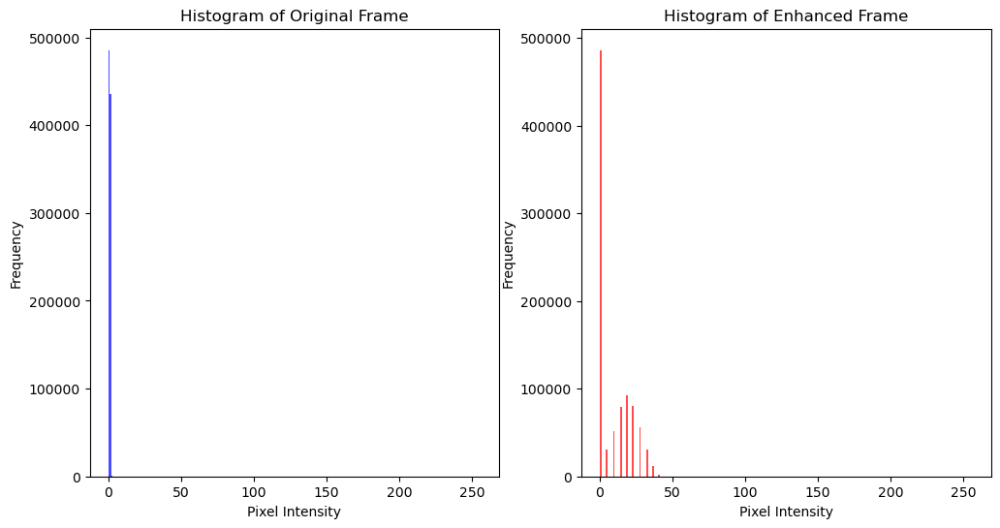

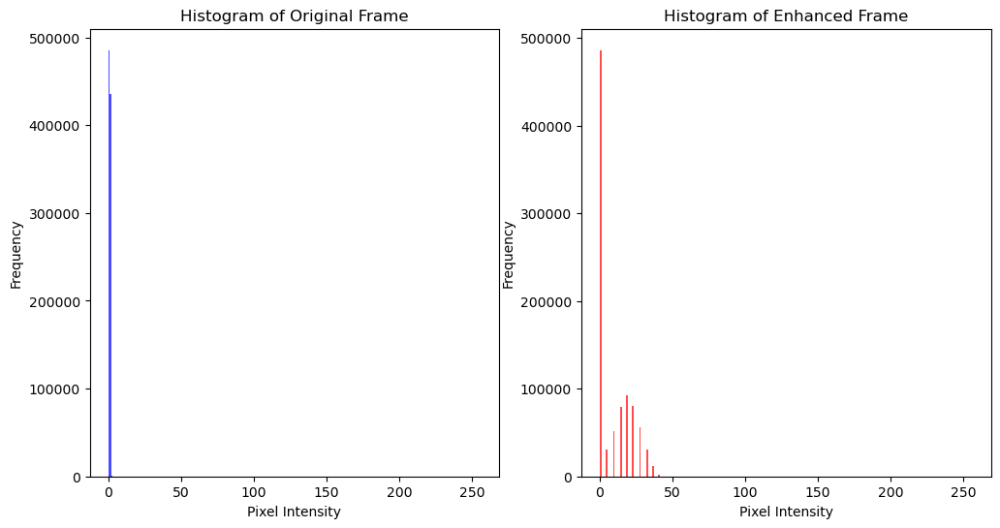

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt 

# Open the webcam
cap = cv2.VideoCapture(1)

# Get original video properties
fps_original = int(cap.get(cv2.CAP_PROP_FPS))
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Specify the desired frame rate
fps_desired = 500  # Adjust this to your desired frame rate

# Create VideoWriter object to save the enhanced video with increased frame rate
output_path = "C:\\Users\\heman\\img_processing_python\\programs\\videos\\enhanced_video_high_fps.avi"
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter(output_path, fourcc, fps_desired, (width, height))

# Dynamic Histogram Equalization
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))

while True:
    ret, frame = cap.read()
    if not ret:
        break

    # Convert frame to RGB
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

    # Apply dynamic histogram equalization
    enhanced_frame = np.zeros_like(frame_rgb)
    for channel in range(3):
        enhanced_frame[:, :, channel] = clahe.apply(frame_rgb[:, :, channel])

    # Simulate multiple exposure levels by adjusting intensity
    exposure_levels = [0.8, 1.0, 1.2]
    exposure_frames = [frame_rgb * exposure for exposure in exposure_levels]

    # Exposure Fusion Framework
    fusion_weights = [1, 1, 1]
    result_frame = np.zeros_like(frame_rgb, dtype=np.float32)
    for i in range(len(exposure_frames)):
        result_frame += fusion_weights[i] * exposure_frames[i].astype(np.float32)

    result_frame = np.clip(result_frame, 0, 255).astype(np.uint8)

    # Sharpening using kernel
    kernel = np.array([[-1, -1, -1],
                       [-1, 9, -1],
                       [-1, -1, -1]])
    sharpened_frame = cv2.filter2D(result_frame, -1, kernel)

    # Simulate ISO adjustment
    iso_adjusted_frame = cv2.addWeighted(sharpened_frame, 1.5, np.zeros_like(sharpened_frame), 0, 0)

    # Enhance resolution using interpolation
    enhanced_resolution_frame = cv2.resize(iso_adjusted_frame, (width, height))

    # Resize the original frame to match the dimensions of enhanced_resolution_frame
    frame_resized = cv2.resize(frame, (width, height))

    # Concatenate original and enhanced frames horizontally
    combined_frame = np.hstack((frame_resized, cv2.cvtColor(enhanced_resolution_frame, cv2.COLOR_RGB2BGR)))

    # Write the enhanced frame to the output video multiple times to increase frame rate
    for _ in range(int(fps_desired / fps_original)):
        out.write(cv2.cvtColor(enhanced_resolution_frame, cv2.COLOR_RGB2BGR))

    # Display the combined frame
    cv2.imshow('Original vs Enhanced', combined_frame)

    # Plot histograms of original and enhanced frames
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.title('Histogram of Original Frame')
    plt.xlabel('Pixel Intensity')
    plt.ylabel('Frequency')
    plt.hist(frame_rgb.flatten(), bins=256, range=[0, 256], color='blue', alpha=0.7)

    plt.subplot(1, 2, 2)
    plt.title('Histogram of Enhanced Frame')
    plt.xlabel('Pixel Intensity')
    plt.ylabel('Frequency')
    plt.hist(enhanced_resolution_frame.flatten(), bins=256, range=[0, 256], color='red', alpha=0.7)

    plt.show()

    if cv2.waitKey(1) & 0xFF == 27:  # Press 'Esc' to exit
        break

    # Add a short delay to allow the OpenCV window to update
    cv2.waitKey(10)

# Release video capture and writer objects
cap.release()
out.release()
cv2.destroyAllWindows()
